In [1]:
from pathlib import Path
import os
import sys 
sys.path.insert(0, str(Path(os.getcwd()).parent.parent))

In [2]:
from lib.helpers.dataloader_helper import build_dataloader
from lib.models.image_processsing_mono3dvg import Mono3DVGImageProcessor, dictlist_to_listdict
from utils.parser import load_yaml_config, dict_to_namespace
from visualization.utils import Mono3DVGPlotter

INFO:numexpr.utils:Note: NumExpr detected 16 cores but "NUMEXPR_MAX_THREADS" not set, so enforcing safe limit of 8.
INFO:numexpr.utils:NumExpr defaulting to 8 threads.
INFO:datasets:PyTorch version 2.4.0 available.


In [3]:
cfg = dict_to_namespace(load_yaml_config({}, Path("../../configs/mono3dvg.yaml")))
cfg.dataset.cache_dir = Path("../../cache")

In [4]:
train_dataloader, valid_dataloader, test_dataloader, id2label, label2id = build_dataloader(cfg)

train, val, test:  29990 5735 5415


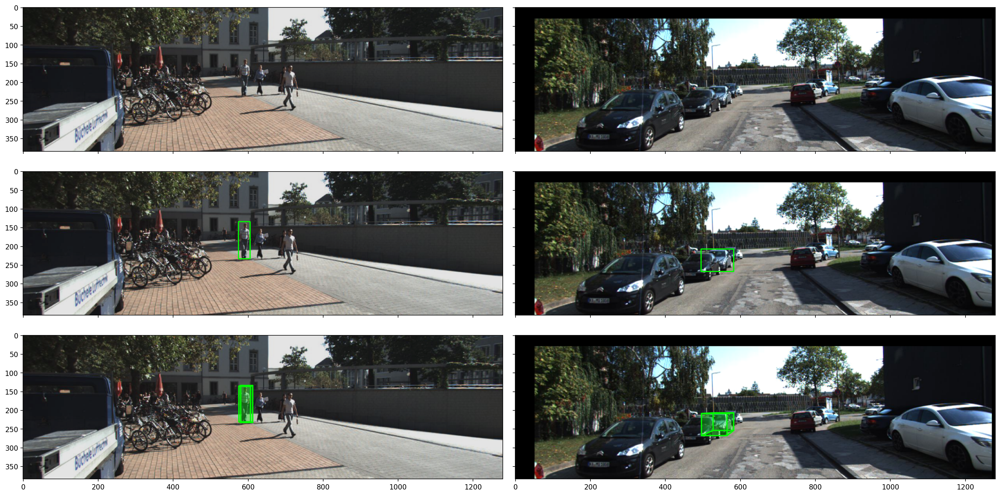

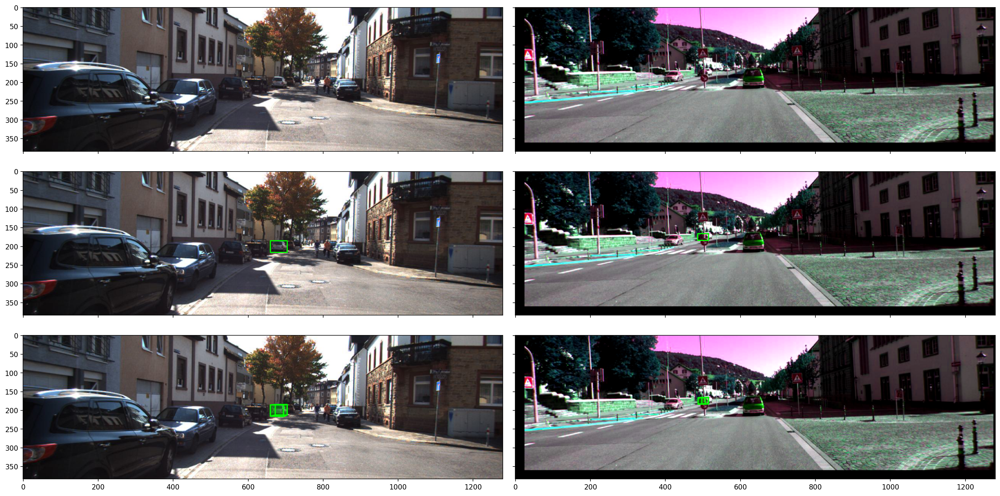

In [5]:
from matplotlib import pyplot as plt

def plot_images(imgs, targets, info):
    # fig, ax = plt.subplots(4, len(imgs), sharex=True, sharey=True, figsize=(20, 13), dpi=160, layout='constrained')
    fig, ax = plt.subplots(3, len(imgs), sharex=True, sharey=True, figsize=(20, 10), dpi=160, layout='constrained')
    for i in range(len(imgs)):
        ax[0][i].imshow(imgs[i])
        ax[1][i].imshow(Mono3DVGPlotter.draw_boxes2d(imgs[i], targets[i]['boxes']))
        ax[2][i].imshow(Mono3DVGPlotter.draw_projected_boxes3d(imgs[i], info[i]['corners_3d'], fill=True))
        # ax[3][i].imshow(Mono3DVGPlotter.draw_depth_map(imgs[i], targets[i]['boxes'], targets[i]['boxes_3d'][..., :2], targets[i]['depth'], gaussian_format='umich'), cmap='gray', vmin=0, vmax=60)
    plt.show()

dataloader = train_dataloader
vis_idx = [5, 6]

for i, batch in enumerate(dataloader):
    if i > max(vis_idx):
        break
    if i in vis_idx:
        imgs = Mono3DVGPlotter.to_pil_images(batch['pixel_values'])
        targets = dictlist_to_listdict(batch['targets'], batch_size=len(imgs))
        targets = [Mono3DVGPlotter.denormalize_annotation(target, img.size) for target, img in zip(targets, imgs)]
        info = dictlist_to_listdict(batch['info'], batch_size=len(imgs))
        info = [Mono3DVGPlotter.denormalize_annotation(inf, img.size) for inf, img in zip(info, imgs)]
        plot_images(imgs[::5], targets[::5], info[::5])

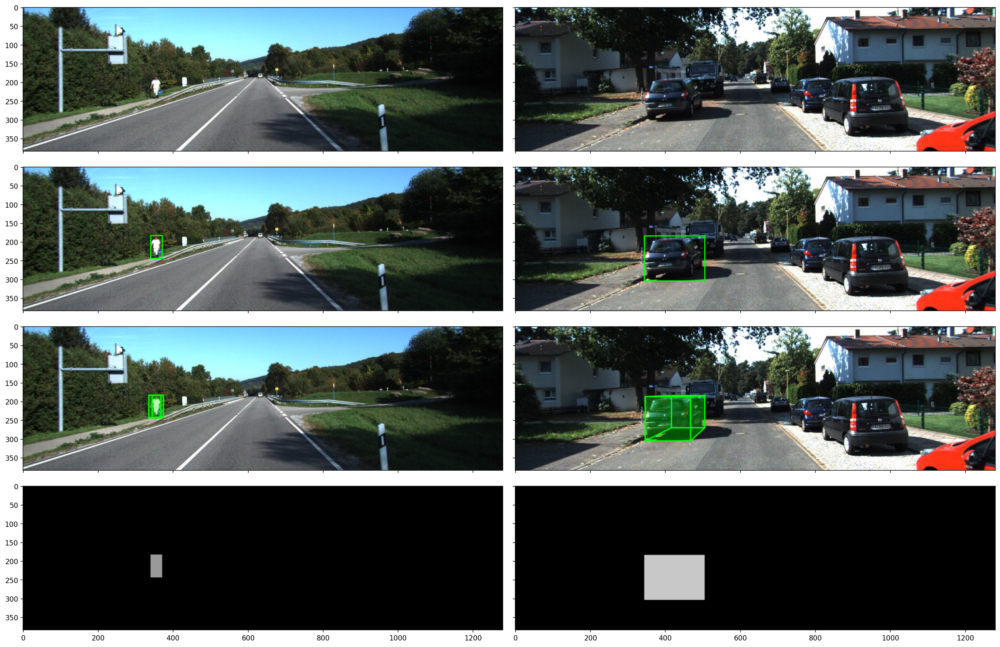

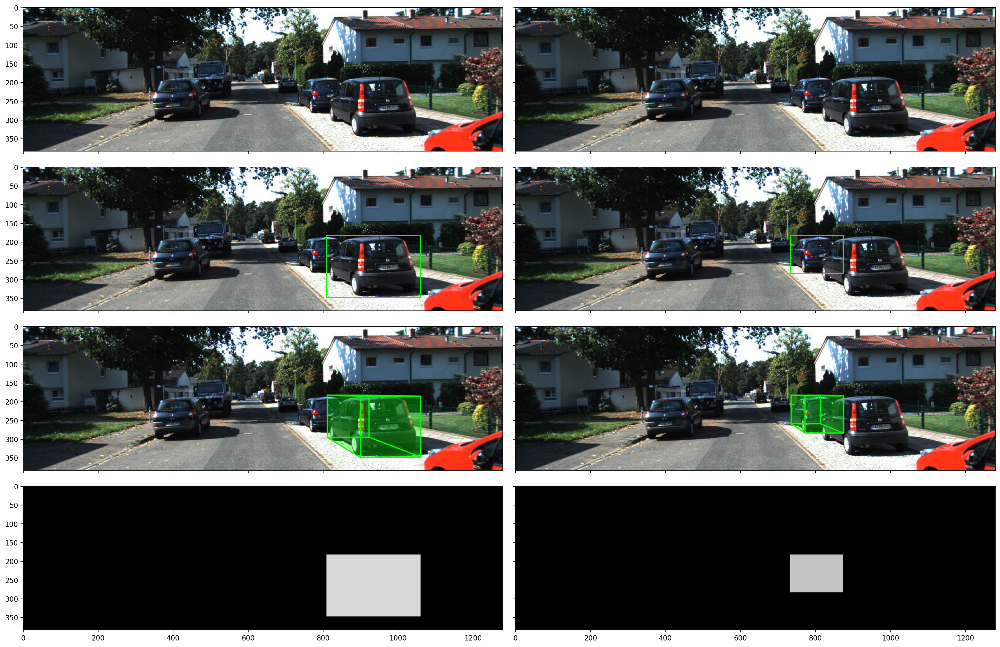

In [6]:
from matplotlib import pyplot as plt

def plot_images(imgs, targets, info):
    fig, ax = plt.subplots(4, len(imgs), sharex=True, sharey=True, figsize=(20, 13), dpi=160, layout='constrained')
    for i in range(len(imgs)):
        ax[0][i].imshow(imgs[i])
        ax[1][i].imshow(Mono3DVGPlotter.draw_boxes2d(imgs[i], targets[i]['boxes']))
        ax[2][i].imshow(Mono3DVGPlotter.draw_projected_boxes3d(imgs[i], info[i]['corners_3d'], fill=True))
        ax[3][i].imshow(Mono3DVGPlotter.draw_depth_map(imgs[i], targets[i]['boxes'], targets[i]['boxes_3d'][..., :2], targets[i]['depth'], gaussian_format='umich'), cmap='gray', vmin=0, vmax=60)
    plt.show()

dataloader = test_dataloader
vis_idx = [3, 4]

for i, batch in enumerate(dataloader):
    if i > max(vis_idx):
        break
    if i in vis_idx:
        imgs = Mono3DVGPlotter.to_pil_images(batch['pixel_values'])
        targets = dictlist_to_listdict(batch['targets'], batch_size=len(imgs))
        targets = [Mono3DVGPlotter.denormalize_annotation(target, img.size) for target, img in zip(targets, imgs)]
        info = dictlist_to_listdict(batch['info'], batch_size=len(imgs))
        info = [Mono3DVGPlotter.denormalize_annotation(inf, img.size) for inf, img in zip(info, imgs)]
        plot_images(imgs[::5], targets[::5], info[::5])

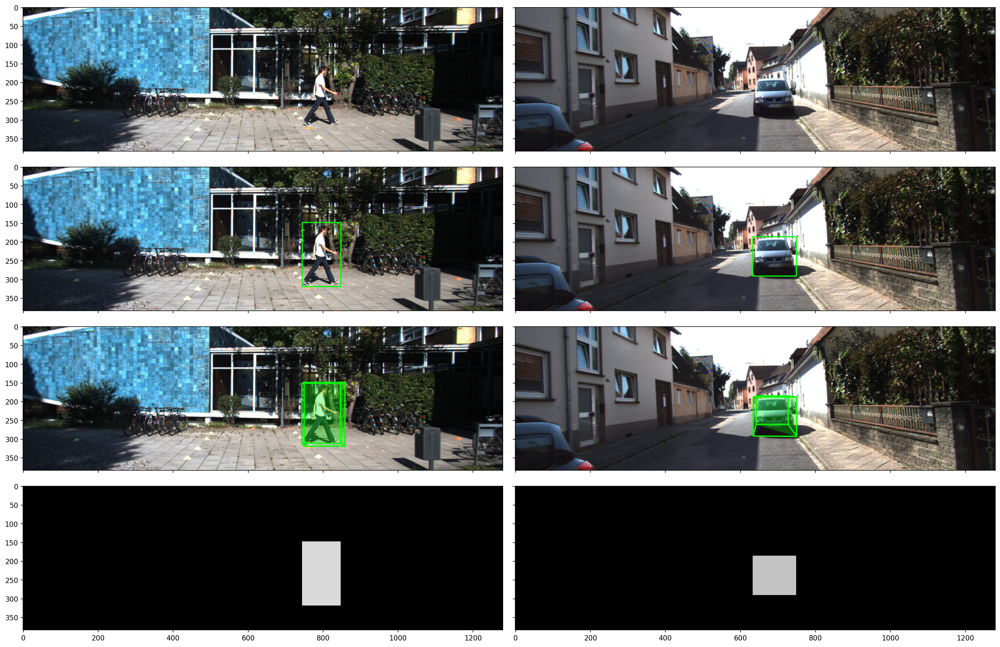

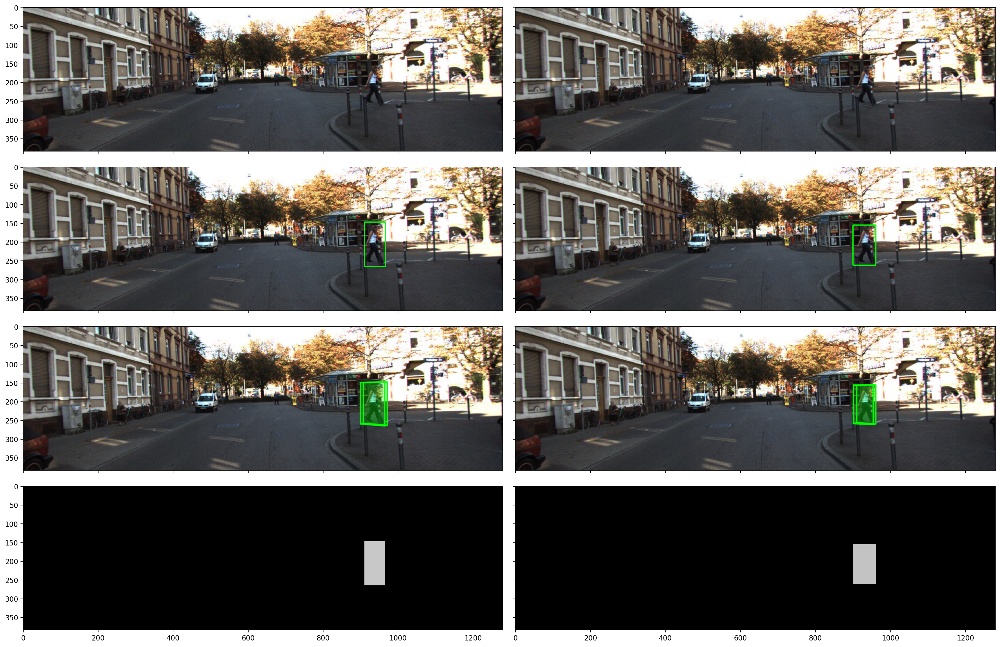

In [7]:
from matplotlib import pyplot as plt

def plot_images(imgs, targets, info):
    fig, ax = plt.subplots(4, len(imgs), sharex=True, sharey=True, figsize=(20, 13), dpi=160, layout='constrained')
    for i in range(len(imgs)):
        ax[0][i].imshow(imgs[i])
        ax[1][i].imshow(Mono3DVGPlotter.draw_boxes2d(imgs[i], targets[i]['boxes']))
        ax[2][i].imshow(Mono3DVGPlotter.draw_projected_boxes3d(imgs[i], info[i]['corners_3d'], fill=True))
        ax[3][i].imshow(Mono3DVGPlotter.draw_depth_map(imgs[i], targets[i]['boxes'], targets[i]['boxes_3d'][..., :2], targets[i]['depth'], gaussian_format='umich'), cmap='gray', vmin=0, vmax=60)
    plt.show()

dataloader = valid_dataloader
vis_idx = [0, 1]

for i, batch in enumerate(dataloader):
    if i > max(vis_idx):
        break
    if i in vis_idx:
        imgs = Mono3DVGPlotter.to_pil_images(batch['pixel_values'])
        targets = dictlist_to_listdict(batch['targets'], batch_size=len(imgs))
        targets = [Mono3DVGPlotter.denormalize_annotation(target, img.size) for target, img in zip(targets, imgs)]
        info = dictlist_to_listdict(batch['info'], batch_size=len(imgs))
        info = [Mono3DVGPlotter.denormalize_annotation(inf, img.size) for inf, img in zip(info, imgs)]
        plot_images(imgs[::5], targets[::5], info[::5])